In [1]:
import matplotlib.pyplot as plt
import pandas as pd
import torch
import torch.optim as optim
from PIL import Image

from unet import UNet
from utils import diagnosis, predict_mask, print_res

In [2]:
PATH_88 = "./models/epoch_88.pt"

In [3]:
results = pd.read_csv("results.csv")
results = results.set_index("epoch")
results = results.sort_index()
results

,training_loss,training_iou,validation_loss,validation_iou
epoch,,,,
0,0.195201,0.576839,0.087555,0.643973
1,0.062784,0.662963,0.043571,0.708771
2,0.039382,0.687802,0.035882,0.690151
3,0.030649,0.717943,0.032148,0.709323
4,0.023515,0.749844,0.029858,0.658386
...,...,...,...,...
89,0.002269,0.951186,0.009867,0.872215
90,0.002300,0.947868,0.011383,0.874194
91,0.003072,0.920725,0.013306,0.831525


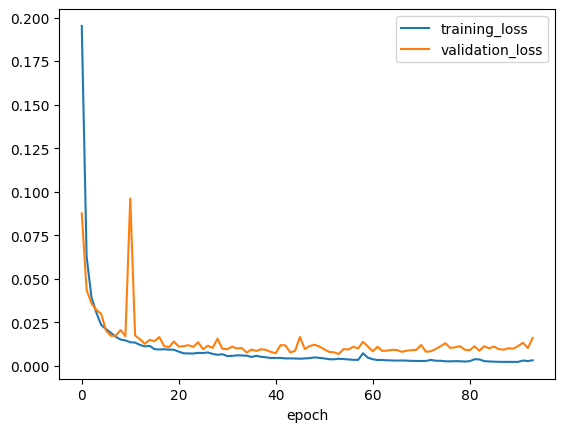

In [4]:
results[["training_loss", "validation_loss"]].plot()
plt.show()

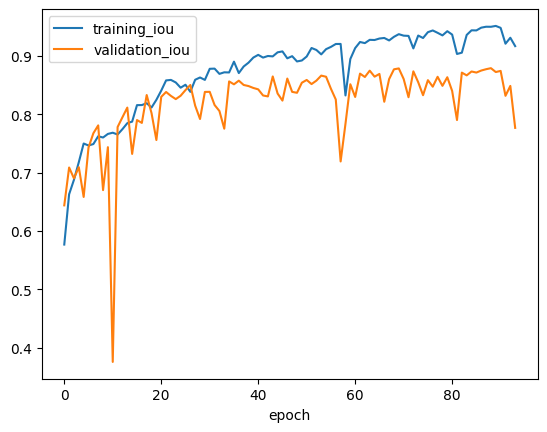

In [5]:
results[["training_iou", "validation_iou"]].plot()
plt.show()

In [6]:
max_val_iou = results["validation_iou"].max()
results[results["validation_iou"] == max_val_iou]

,training_loss,training_iou,validation_loss,validation_iou
epoch,,,,
88,0.002301,0.949717,0.010092,0.878844


In [7]:
pd.set_option("max_colwidth", None)
df_test = pd.read_csv("test.csv")
df_test["tumor"] = df_test["mask_path"].apply(lambda m: diagnosis(m))
df_test

,patient,image_path,mask_path,tumor
0,TCGA_DU_7010_19860307,./lgg-mri-segmentation/kaggle_3m/TCGA_DU_7010_19860307/TCGA_DU_7010_19860307_2.tif,./lgg-mri-segmentation/kaggle_3m/TCGA_DU_7010_19860307/TCGA_DU_7010_19860307_2_mask.tif,False
1,TCGA_DU_7010_19860307,./lgg-mri-segmentation/kaggle_3m/TCGA_DU_7010_19860307/TCGA_DU_7010_19860307_6.tif,./lgg-mri-segmentation/kaggle_3m/TCGA_DU_7010_19860307/TCGA_DU_7010_19860307_6_mask.tif,False
2,TCGA_DU_7010_19860307,./lgg-mri-segmentation/kaggle_3m/TCGA_DU_7010_19860307/TCGA_DU_7010_19860307_52.tif,./lgg-mri-segmentation/kaggle_3m/TCGA_DU_7010_19860307/TCGA_DU_7010_19860307_52_mask.tif,False
3,TCGA_DU_7010_19860307,./lgg-mri-segmentation/kaggle_3m/TCGA_DU_7010_19860307/TCGA_DU_7010_19860307_57.tif,./lgg-mri-segmentation/kaggle_3m/TCGA_DU_7010_19860307/TCGA_DU_7010_19860307_57_mask.tif,False
4,TCGA_DU_7010_19860307,./lgg-mri-segmentation/kaggle_3m/TCGA_DU_7010_19860307/TCGA_DU_7010_19860307_56.tif,./lgg-mri-segmentation/kaggle_3m/TCGA_DU_7010_19860307/TCGA_DU_7010_19860307_56_mask.tif,False
...,...,...,...,...
395,TCGA_CS_4943_20000902,./lgg-mri-segmentation/kaggle_3m/TCGA_CS_4943_20000902/TCGA_CS_4943_20000902_19.tif,./lgg-mri-segmentation/kaggle_3m/TCGA_CS_4943_20000902/TCGA_CS_4943_20000902_19_mask.tif,True
396,TCGA_CS_4943_20000902,./lgg-mri-segmentation/kaggle_3m/TCGA_CS_4943_20000902/TCGA_CS_4943_20000902_14.tif,./lgg-mri-segmentation/kaggle_3m/TCGA_CS_4943_20000902/TCGA_CS_4943_20000902_14_mask.tif,True
397,TCGA_CS_4943_20000902,./lgg-mri-segmentation/kaggle_3m/TCGA_CS_4943_20000902/TCGA_CS_4943_20000902_6.tif,./lgg-mri-segmentation/kaggle_3m/TCGA_CS_4943_20000902/TCGA_CS_4943_20000902_6_mask.tif,False
398,TCGA_CS_4943_20000902,./lgg-mri-segmentation/kaggle_3m/TCGA_CS_4943_20000902/TCGA_CS_4943_20000902_18.tif,./lgg-mri-segmentation/kaggle_3m/TCGA_CS_4943_20000902/TCGA_CS_4943_20000902_18_mask.tif,True


In [8]:
tumors = df_test[df_test["tumor"] == True]
no_tumors = df_test[df_test["tumor"] == False]

./lgg-mri-segmentation/kaggle_3m/TCGA_DU_7010_19860307/TCGA_DU_7010_19860307_31.tif


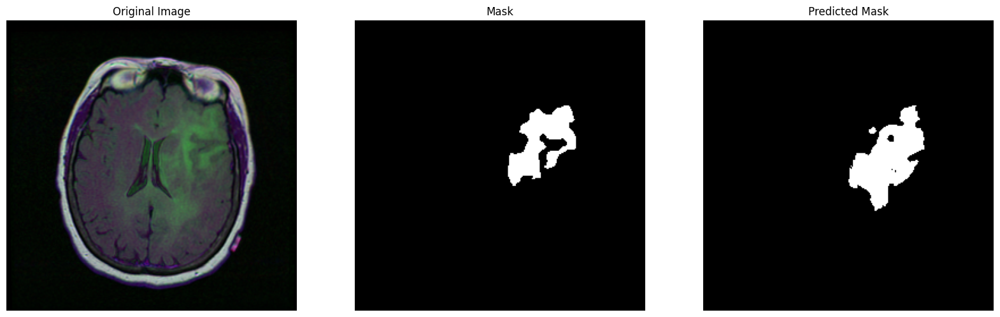

./lgg-mri-segmentation/kaggle_3m/TCGA_DU_7010_19860307/TCGA_DU_7010_19860307_44.tif


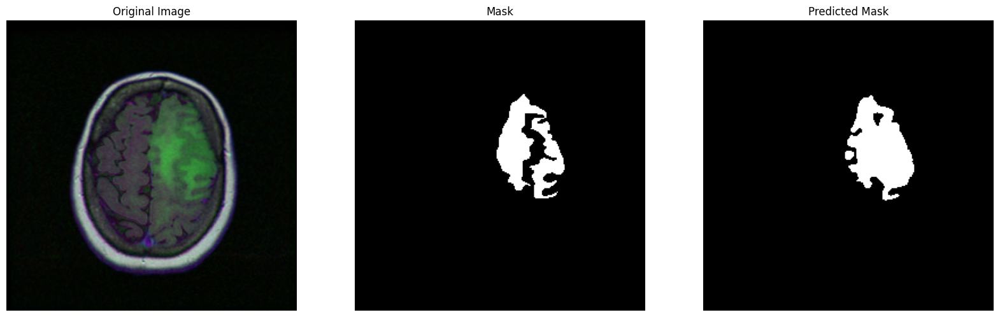

./lgg-mri-segmentation/kaggle_3m/TCGA_DU_7010_19860307/TCGA_DU_7010_19860307_33.tif


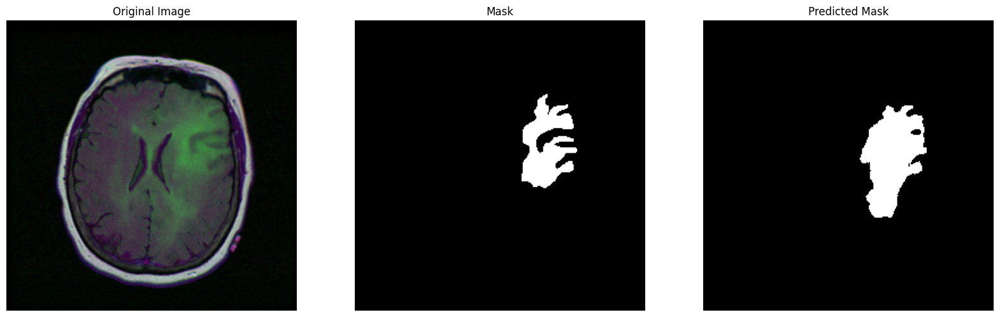

./lgg-mri-segmentation/kaggle_3m/TCGA_DU_7010_19860307/TCGA_DU_7010_19860307_37.tif


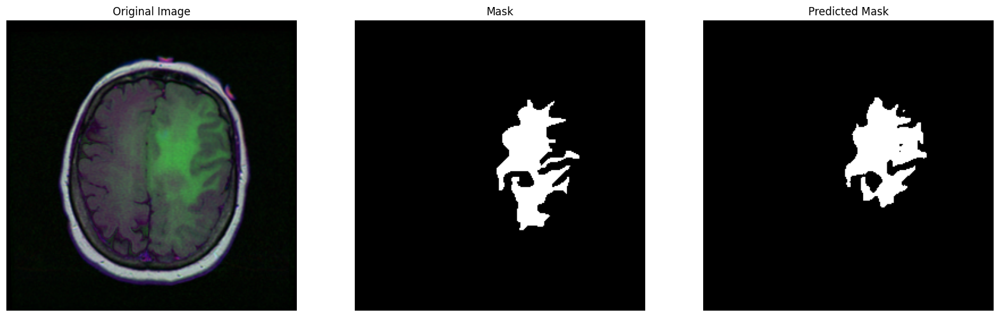

./lgg-mri-segmentation/kaggle_3m/TCGA_DU_7010_19860307/TCGA_DU_7010_19860307_32.tif


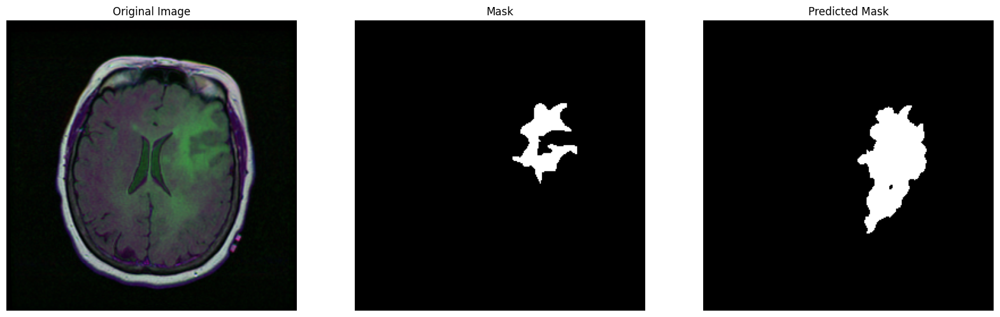

./lgg-mri-segmentation/kaggle_3m/TCGA_DU_7010_19860307/TCGA_DU_7010_19860307_48.tif


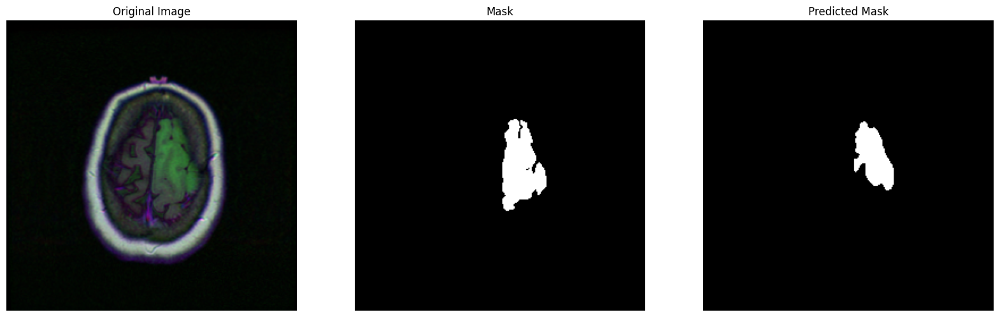

./lgg-mri-segmentation/kaggle_3m/TCGA_DU_7010_19860307/TCGA_DU_7010_19860307_39.tif


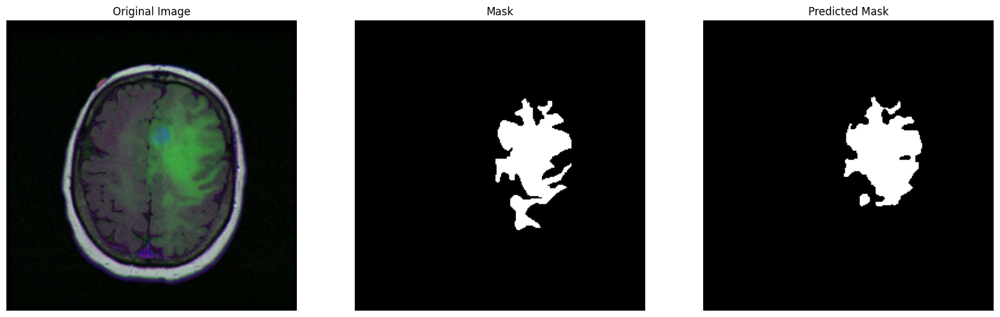

./lgg-mri-segmentation/kaggle_3m/TCGA_DU_7010_19860307/TCGA_DU_7010_19860307_45.tif


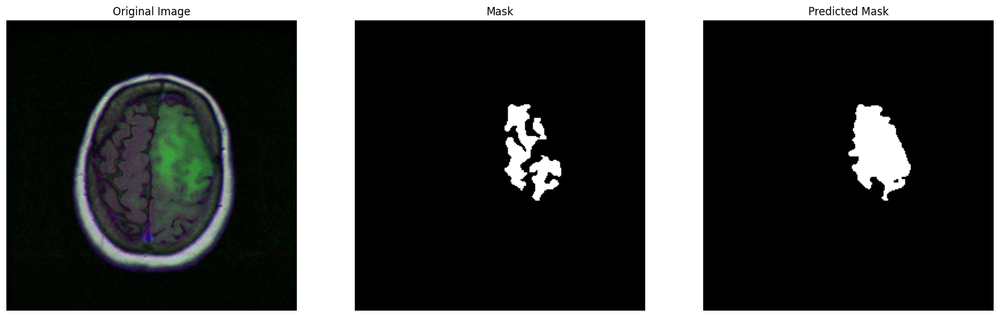

./lgg-mri-segmentation/kaggle_3m/TCGA_DU_7010_19860307/TCGA_DU_7010_19860307_49.tif


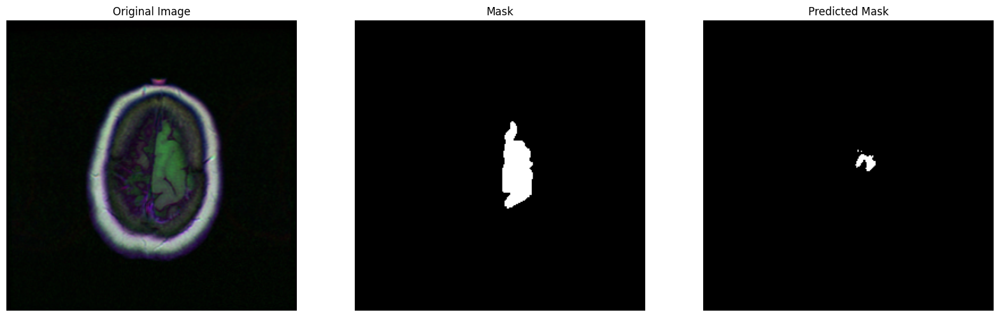

./lgg-mri-segmentation/kaggle_3m/TCGA_DU_7010_19860307/TCGA_DU_7010_19860307_46.tif


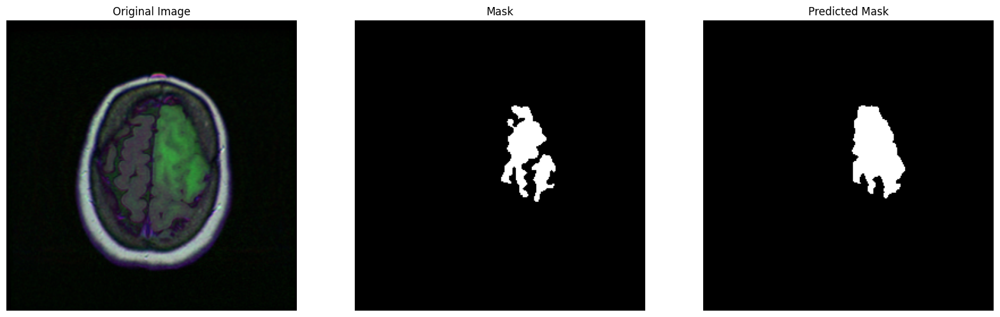

./lgg-mri-segmentation/kaggle_3m/TCGA_DU_7010_19860307/TCGA_DU_7010_19860307_27.tif


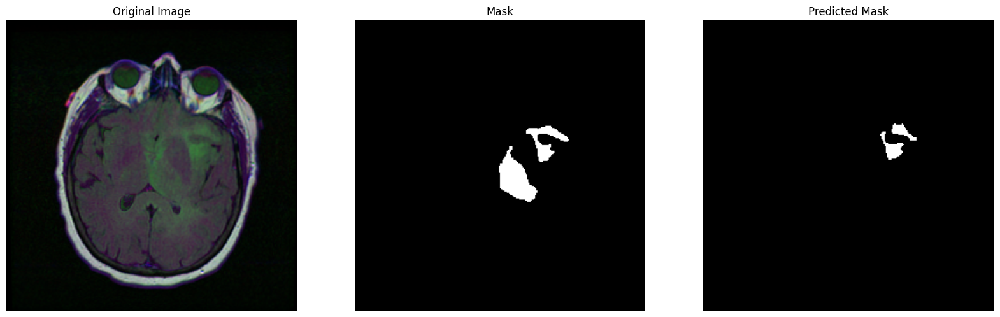

./lgg-mri-segmentation/kaggle_3m/TCGA_DU_7010_19860307/TCGA_DU_7010_19860307_36.tif


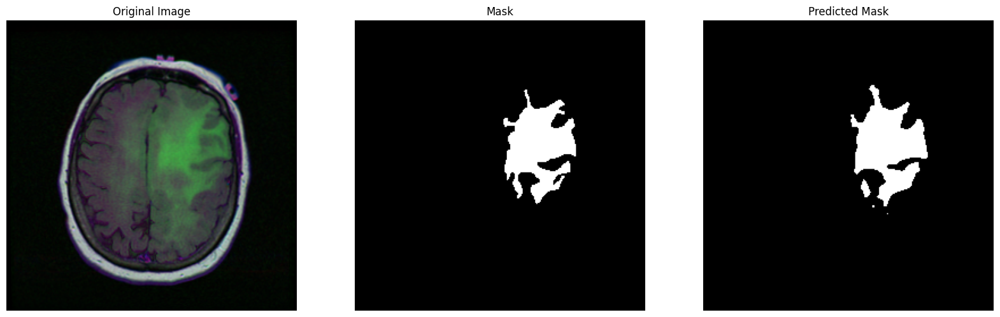

./lgg-mri-segmentation/kaggle_3m/TCGA_DU_7010_19860307/TCGA_DU_7010_19860307_41.tif


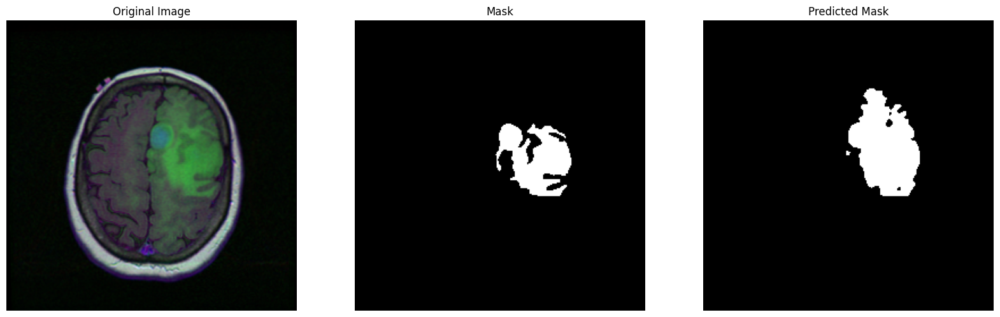

./lgg-mri-segmentation/kaggle_3m/TCGA_DU_7010_19860307/TCGA_DU_7010_19860307_50.tif


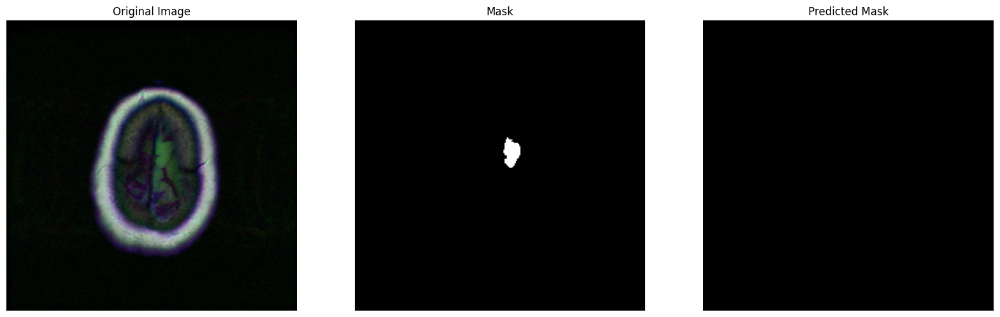

./lgg-mri-segmentation/kaggle_3m/TCGA_DU_7010_19860307/TCGA_DU_7010_19860307_25.tif


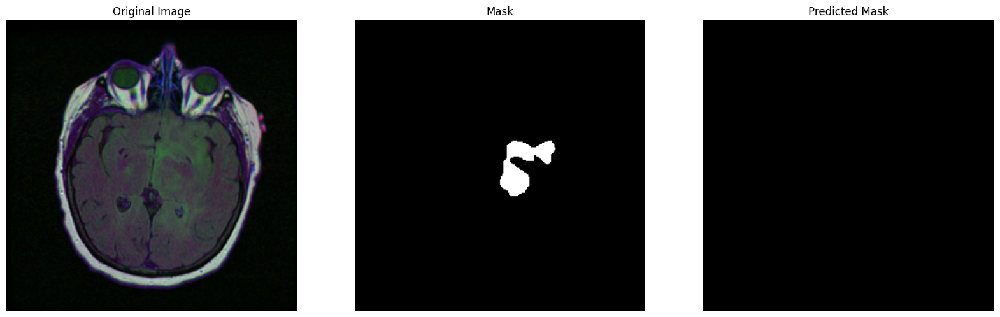

./lgg-mri-segmentation/kaggle_3m/TCGA_DU_7010_19860307/TCGA_DU_7010_19860307_29.tif


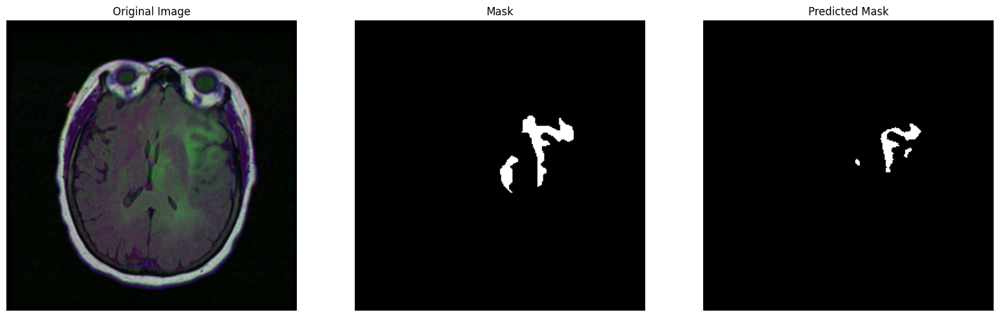

./lgg-mri-segmentation/kaggle_3m/TCGA_DU_7010_19860307/TCGA_DU_7010_19860307_26.tif


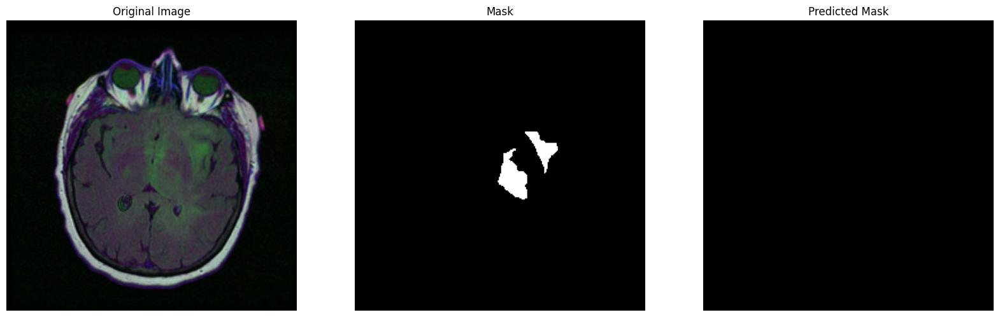

./lgg-mri-segmentation/kaggle_3m/TCGA_DU_7010_19860307/TCGA_DU_7010_19860307_28.tif


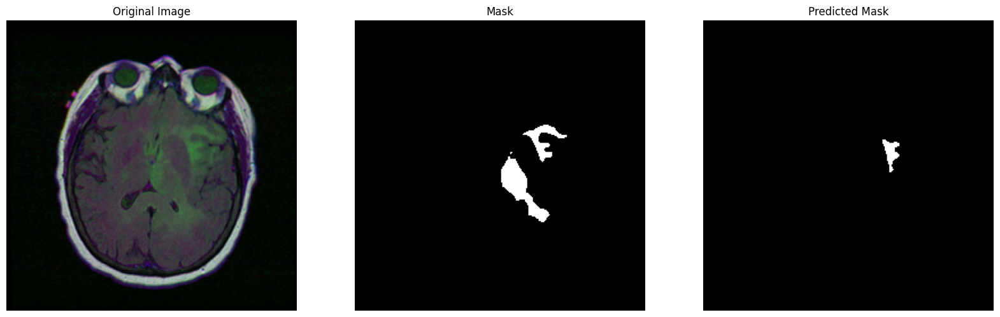

./lgg-mri-segmentation/kaggle_3m/TCGA_DU_7010_19860307/TCGA_DU_7010_19860307_42.tif


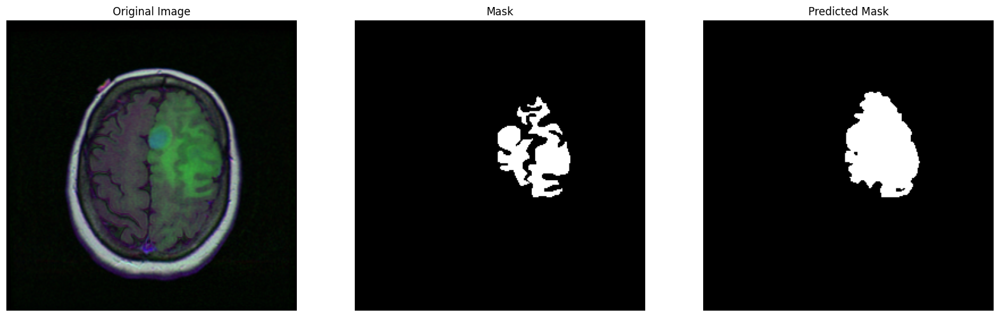

./lgg-mri-segmentation/kaggle_3m/TCGA_DU_7010_19860307/TCGA_DU_7010_19860307_35.tif


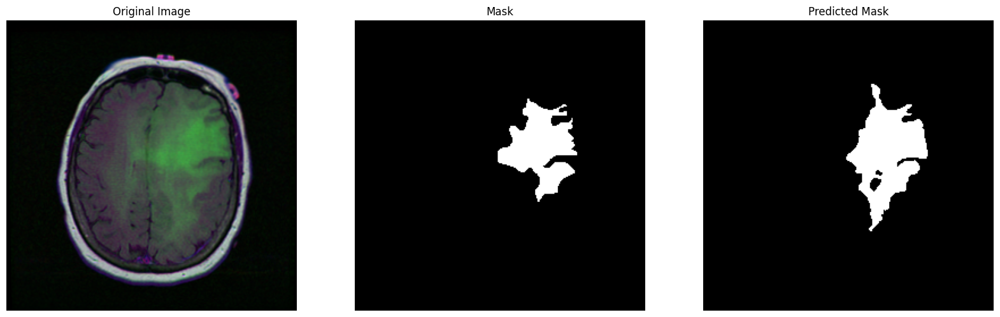

./lgg-mri-segmentation/kaggle_3m/TCGA_DU_7010_19860307/TCGA_DU_7010_19860307_43.tif


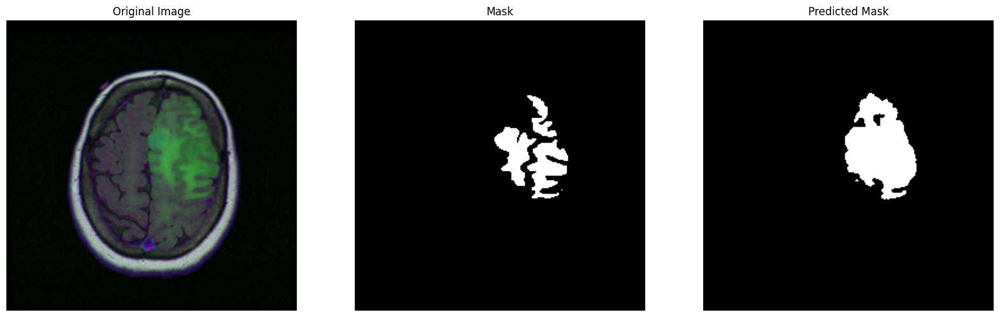

./lgg-mri-segmentation/kaggle_3m/TCGA_DU_7010_19860307/TCGA_DU_7010_19860307_47.tif


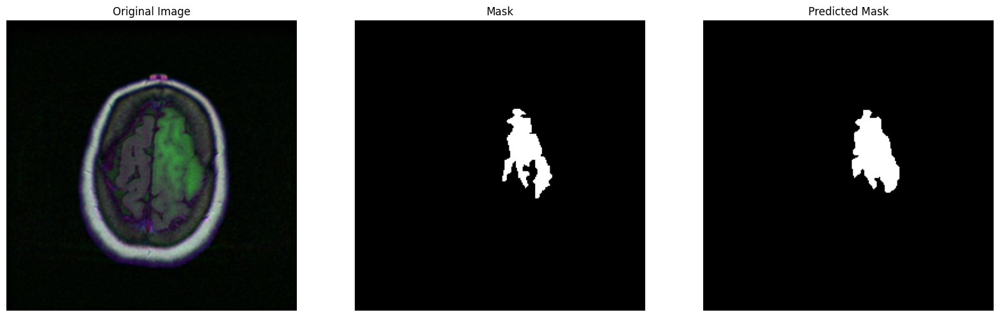

./lgg-mri-segmentation/kaggle_3m/TCGA_DU_7010_19860307/TCGA_DU_7010_19860307_24.tif


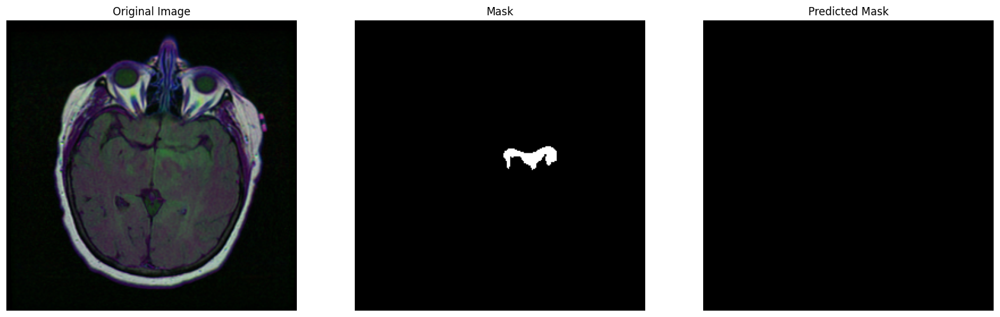

./lgg-mri-segmentation/kaggle_3m/TCGA_DU_7010_19860307/TCGA_DU_7010_19860307_38.tif


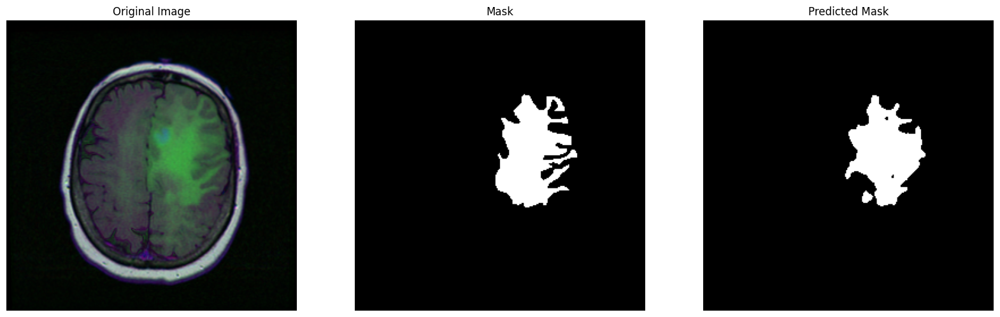

./lgg-mri-segmentation/kaggle_3m/TCGA_DU_7010_19860307/TCGA_DU_7010_19860307_34.tif


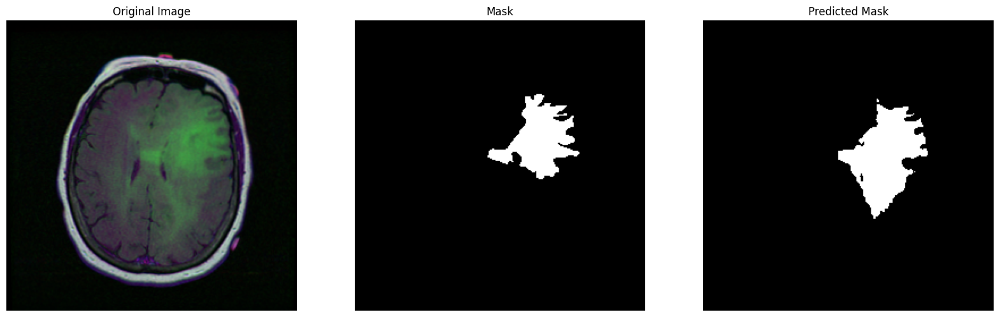

./lgg-mri-segmentation/kaggle_3m/TCGA_DU_7010_19860307/TCGA_DU_7010_19860307_30.tif


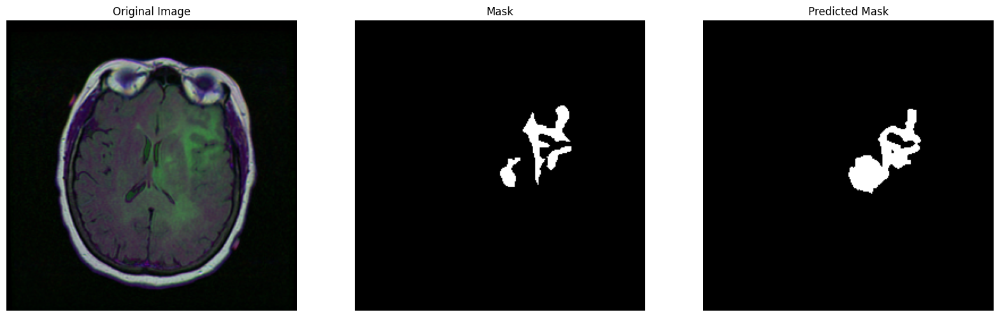

./lgg-mri-segmentation/kaggle_3m/TCGA_DU_7010_19860307/TCGA_DU_7010_19860307_40.tif


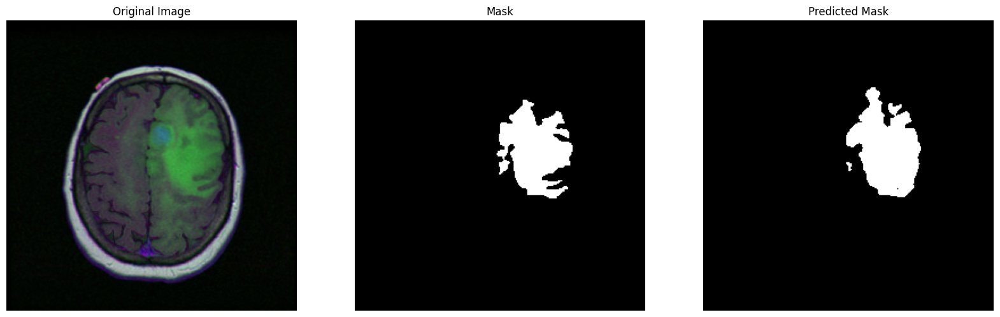

./lgg-mri-segmentation/kaggle_3m/TCGA_DU_5851_19950428/TCGA_DU_5851_19950428_14.tif


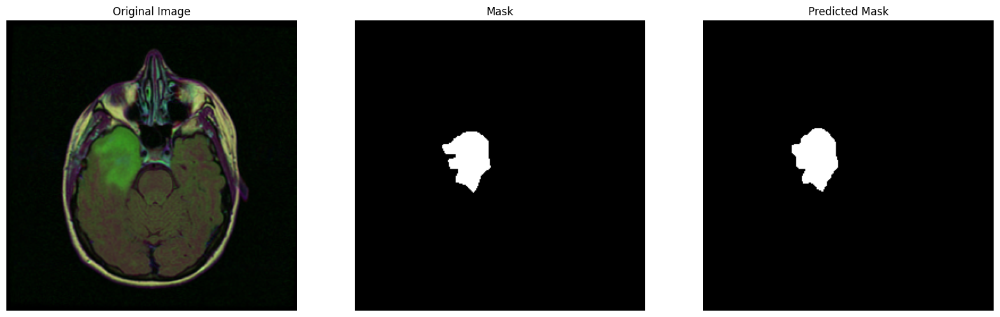

./lgg-mri-segmentation/kaggle_3m/TCGA_DU_5851_19950428/TCGA_DU_5851_19950428_12.tif


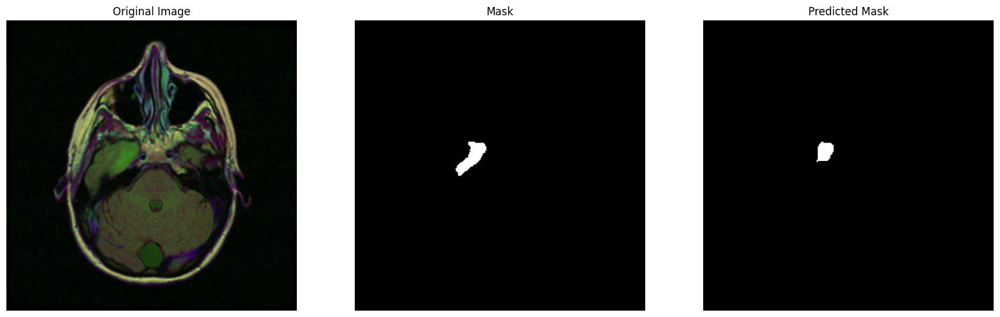

./lgg-mri-segmentation/kaggle_3m/TCGA_DU_5851_19950428/TCGA_DU_5851_19950428_13.tif


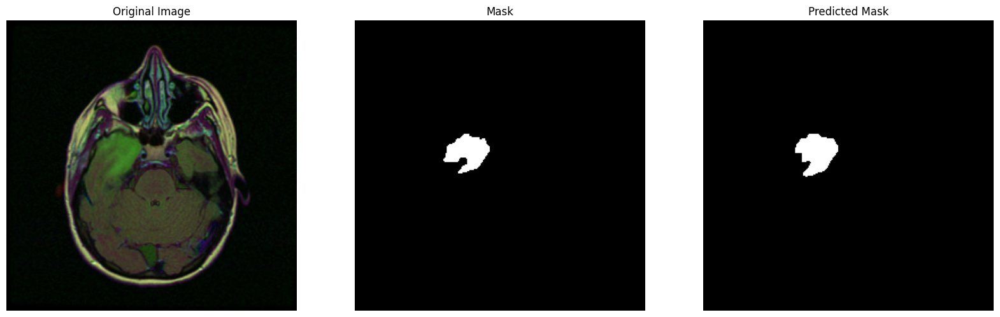

./lgg-mri-segmentation/kaggle_3m/TCGA_DU_5851_19950428/TCGA_DU_5851_19950428_18.tif


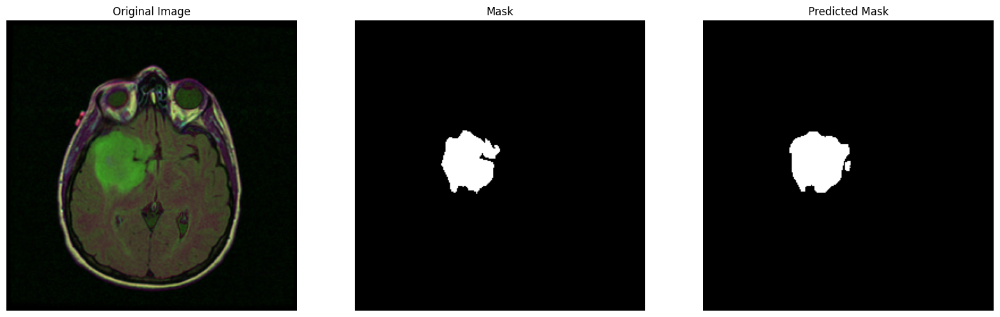

./lgg-mri-segmentation/kaggle_3m/TCGA_DU_5851_19950428/TCGA_DU_5851_19950428_17.tif


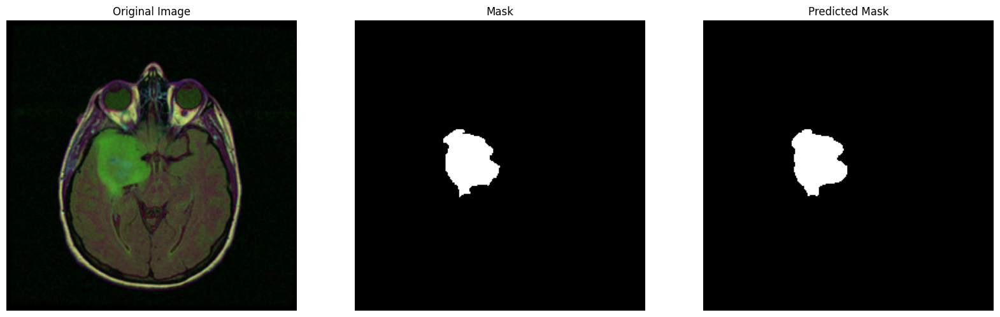

./lgg-mri-segmentation/kaggle_3m/TCGA_DU_5851_19950428/TCGA_DU_5851_19950428_15.tif


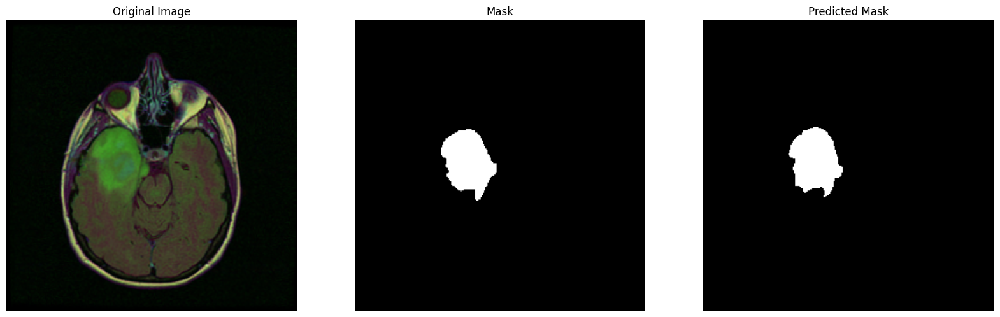

./lgg-mri-segmentation/kaggle_3m/TCGA_DU_5851_19950428/TCGA_DU_5851_19950428_22.tif


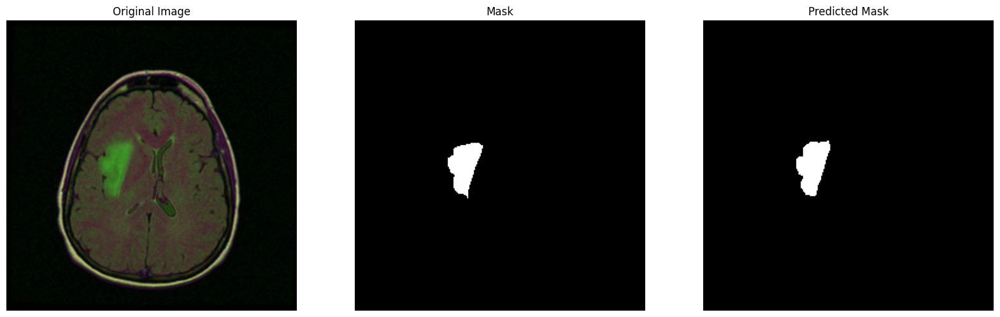

./lgg-mri-segmentation/kaggle_3m/TCGA_DU_5851_19950428/TCGA_DU_5851_19950428_24.tif


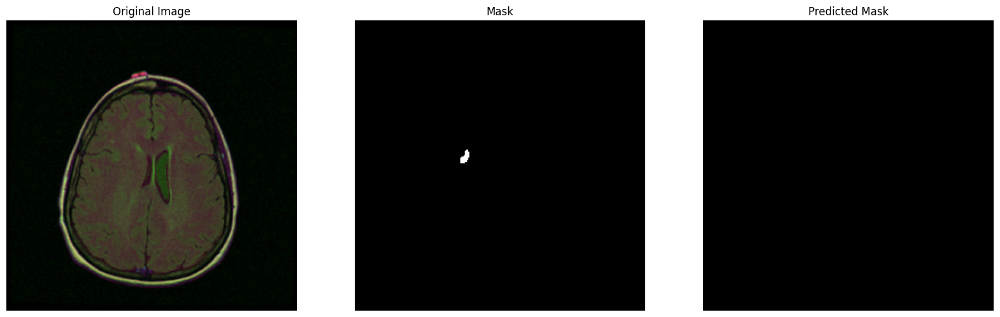

./lgg-mri-segmentation/kaggle_3m/TCGA_DU_5851_19950428/TCGA_DU_5851_19950428_19.tif


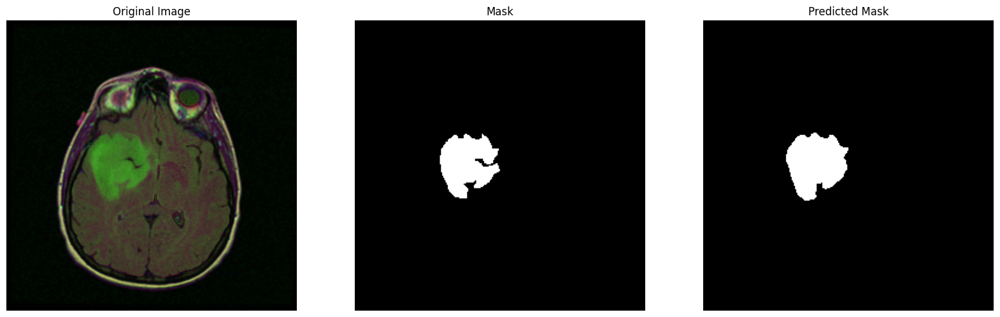

./lgg-mri-segmentation/kaggle_3m/TCGA_DU_5851_19950428/TCGA_DU_5851_19950428_23.tif


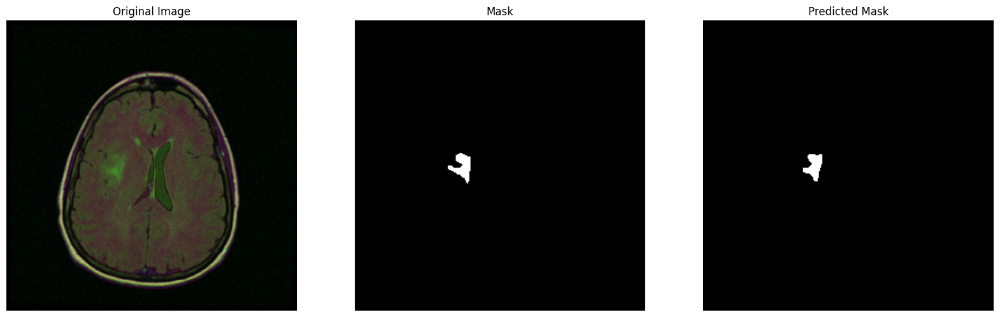

./lgg-mri-segmentation/kaggle_3m/TCGA_DU_5851_19950428/TCGA_DU_5851_19950428_20.tif


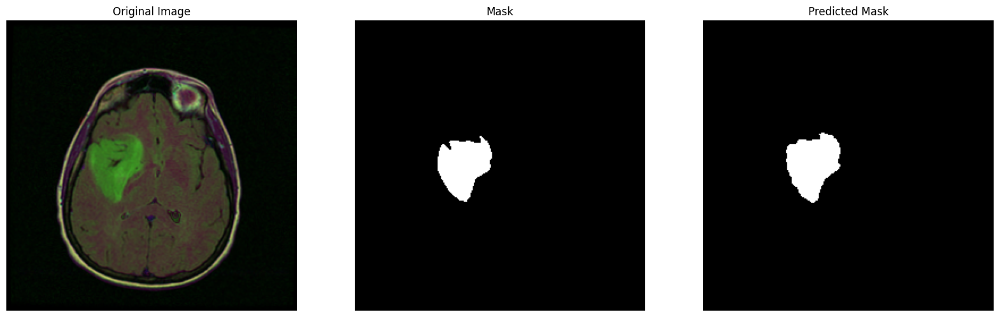

./lgg-mri-segmentation/kaggle_3m/TCGA_DU_5851_19950428/TCGA_DU_5851_19950428_21.tif


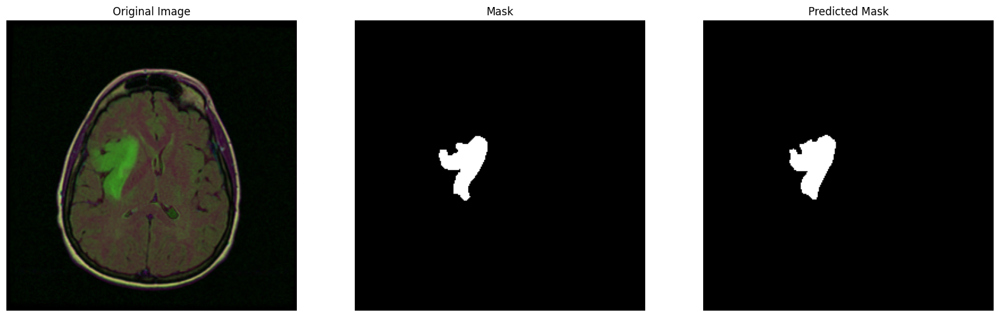

./lgg-mri-segmentation/kaggle_3m/TCGA_DU_5851_19950428/TCGA_DU_5851_19950428_16.tif


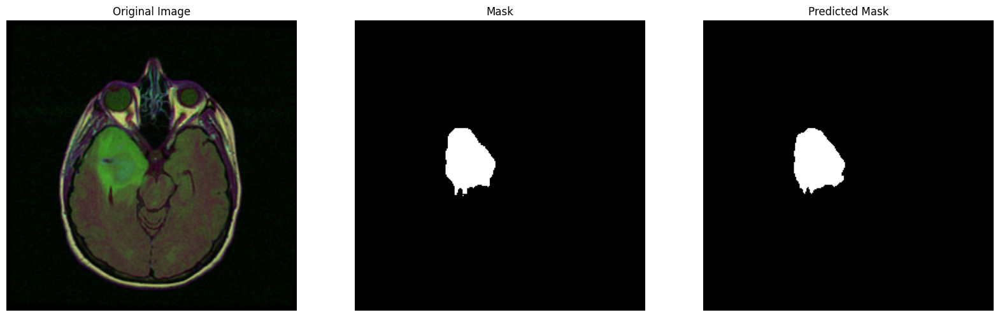

./lgg-mri-segmentation/kaggle_3m/TCGA_FG_6691_20020405/TCGA_FG_6691_20020405_22.tif


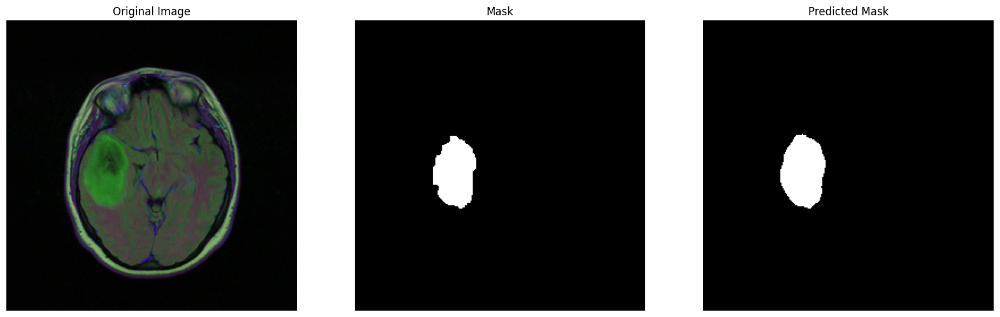

./lgg-mri-segmentation/kaggle_3m/TCGA_FG_6691_20020405/TCGA_FG_6691_20020405_25.tif


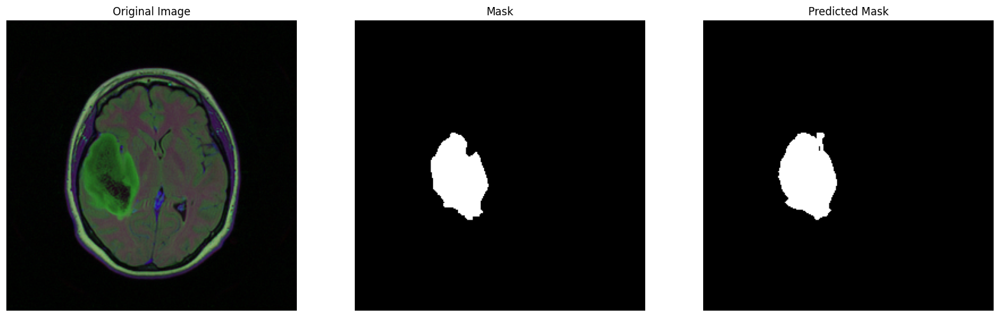

./lgg-mri-segmentation/kaggle_3m/TCGA_FG_6691_20020405/TCGA_FG_6691_20020405_29.tif


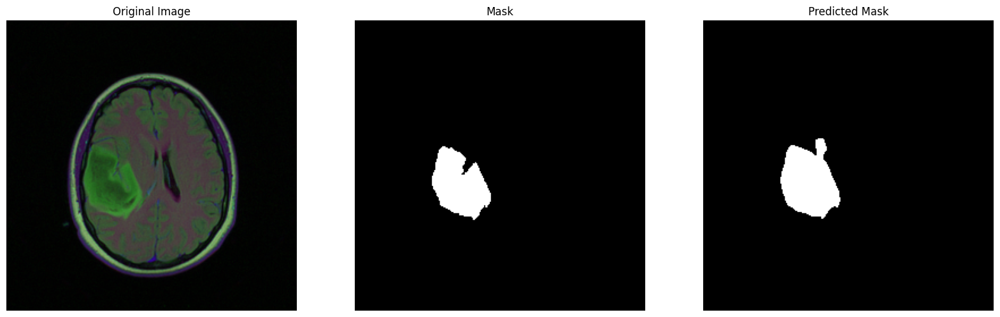

./lgg-mri-segmentation/kaggle_3m/TCGA_FG_6691_20020405/TCGA_FG_6691_20020405_24.tif


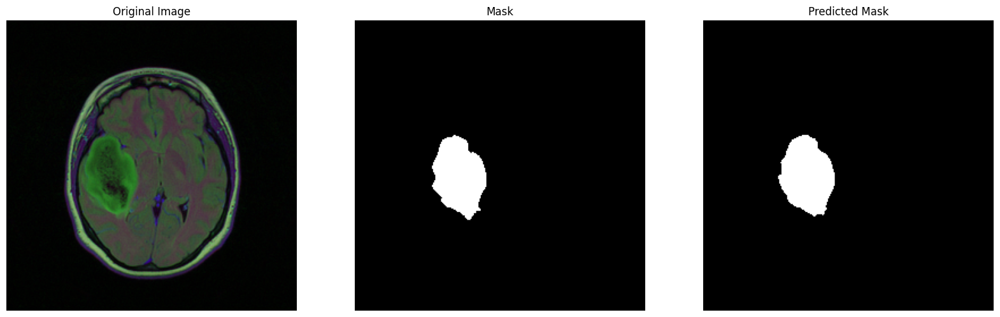

./lgg-mri-segmentation/kaggle_3m/TCGA_FG_6691_20020405/TCGA_FG_6691_20020405_30.tif


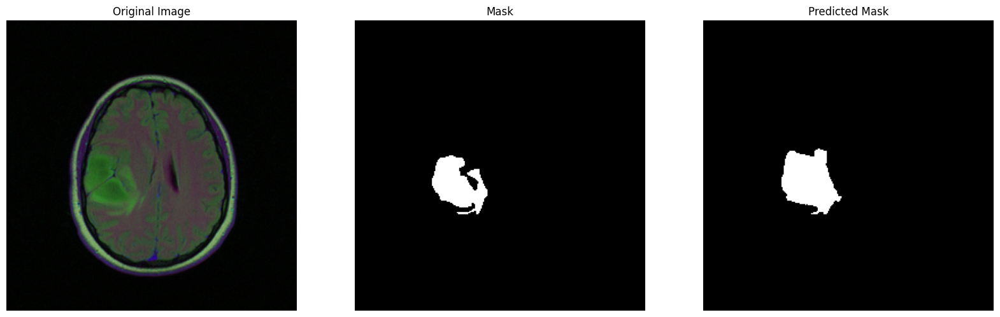

./lgg-mri-segmentation/kaggle_3m/TCGA_FG_6691_20020405/TCGA_FG_6691_20020405_28.tif


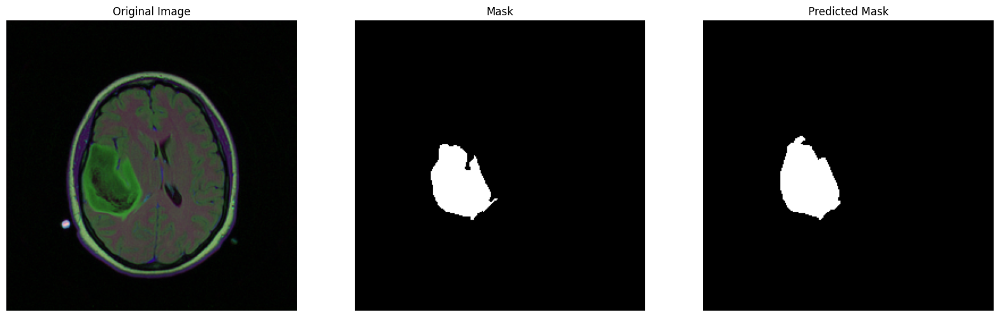

./lgg-mri-segmentation/kaggle_3m/TCGA_FG_6691_20020405/TCGA_FG_6691_20020405_31.tif


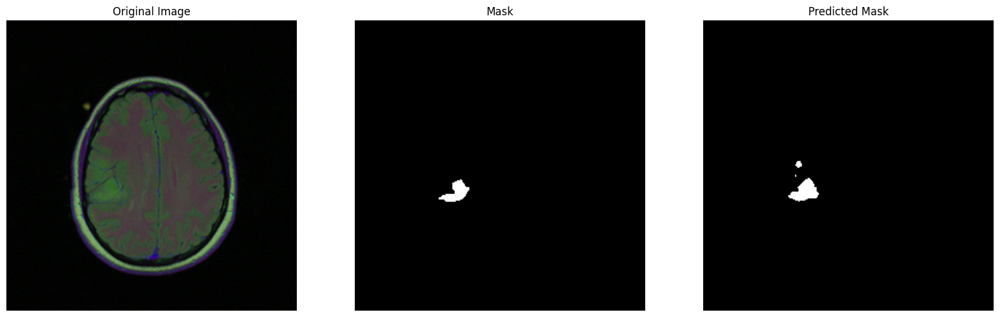

./lgg-mri-segmentation/kaggle_3m/TCGA_FG_6691_20020405/TCGA_FG_6691_20020405_27.tif


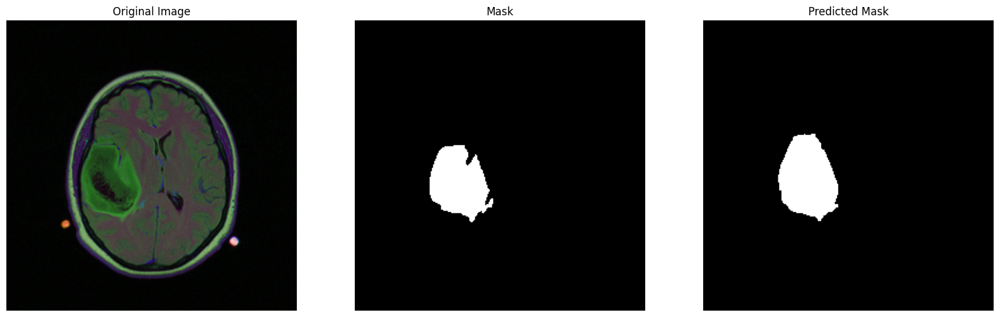

./lgg-mri-segmentation/kaggle_3m/TCGA_FG_6691_20020405/TCGA_FG_6691_20020405_20.tif


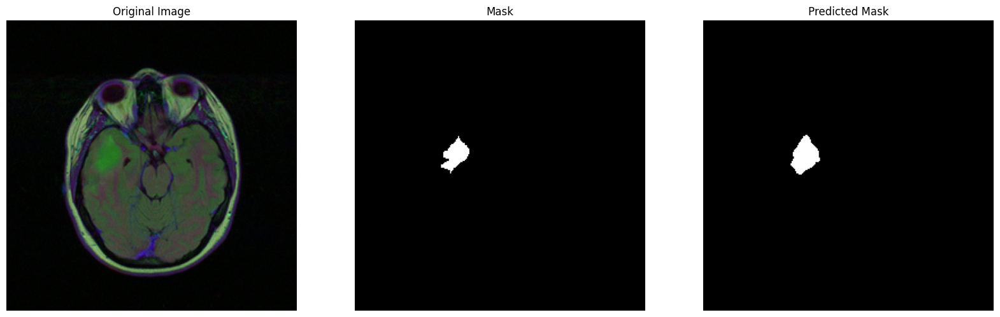

./lgg-mri-segmentation/kaggle_3m/TCGA_FG_6691_20020405/TCGA_FG_6691_20020405_26.tif


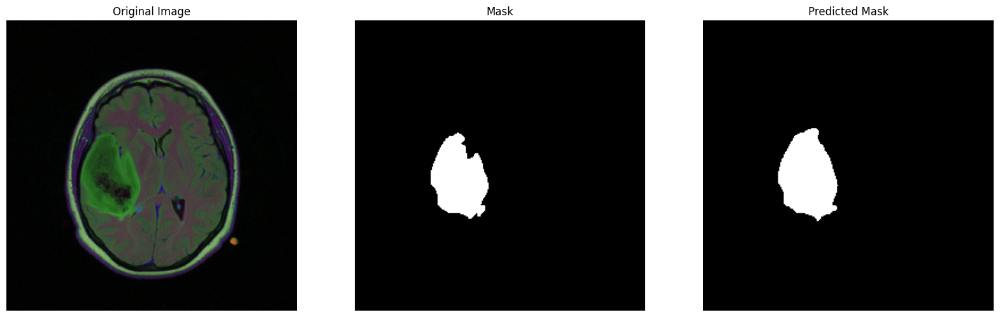

In [9]:
model = UNet(n_channels=3, n_classes=1)
optimizer = optim.Adam(model.parameters(), lr=0.001)

checkpoint = torch.load(PATH_88, map_location=torch.device('cpu'))
model.load_state_dict(checkpoint['model_state_dict'])
optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
epoch = checkpoint['epoch']
model.eval()
# model.to(device)

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
for image_path, mask_path in zip(tumors["image_path"][:50], tumors["mask_path"][:50]):
    print(image_path)
    predicted_mask = predict_mask(model, image_path, device)
    image = Image.open(image_path)
    mask = Image.open(mask_path)
    print_res(image, mask, predicted_mask)

./lgg-mri-segmentation/kaggle_3m/TCGA_DU_7010_19860307/TCGA_DU_7010_19860307_2.tif


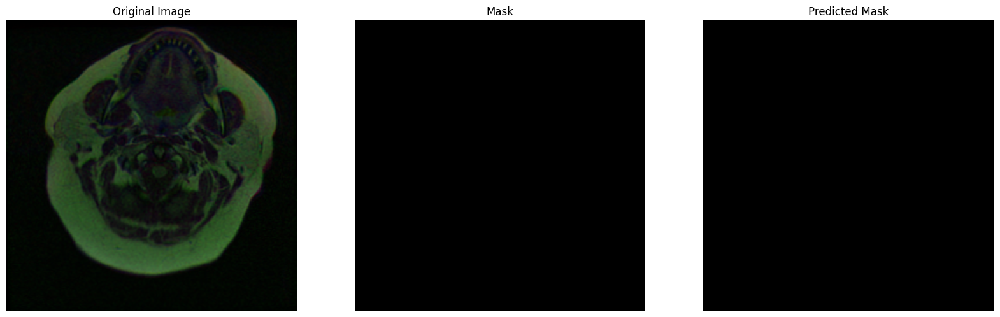

./lgg-mri-segmentation/kaggle_3m/TCGA_DU_7010_19860307/TCGA_DU_7010_19860307_6.tif


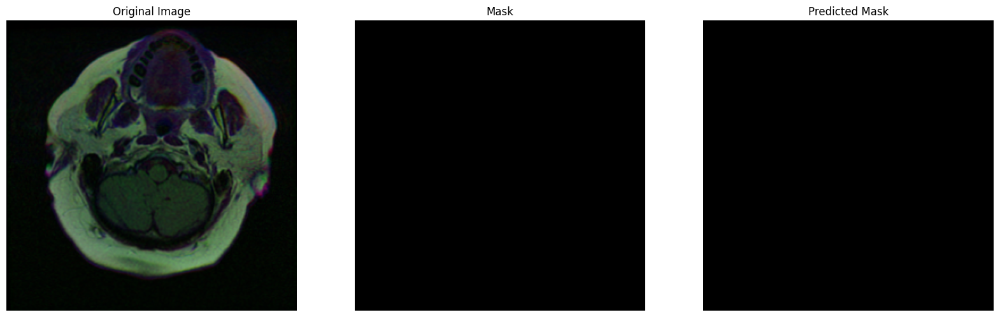

./lgg-mri-segmentation/kaggle_3m/TCGA_DU_7010_19860307/TCGA_DU_7010_19860307_52.tif


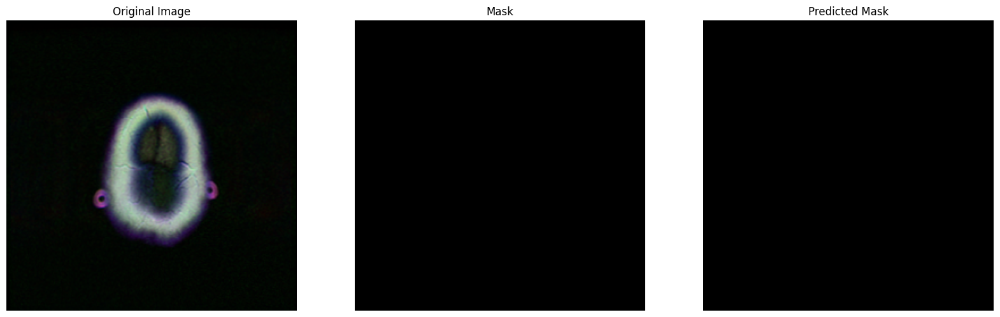

./lgg-mri-segmentation/kaggle_3m/TCGA_DU_7010_19860307/TCGA_DU_7010_19860307_57.tif


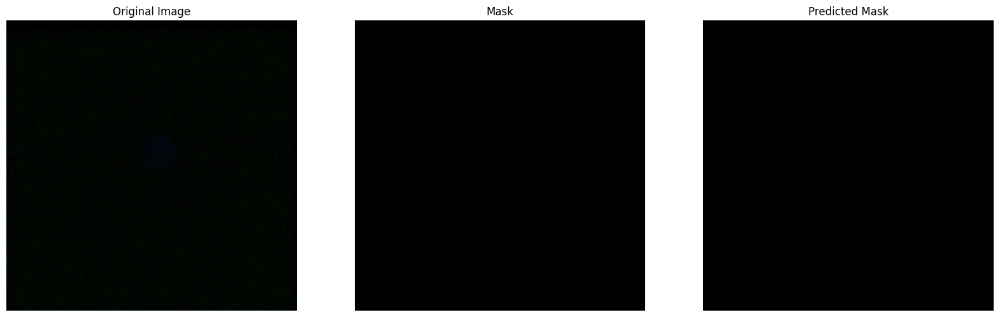

./lgg-mri-segmentation/kaggle_3m/TCGA_DU_7010_19860307/TCGA_DU_7010_19860307_56.tif


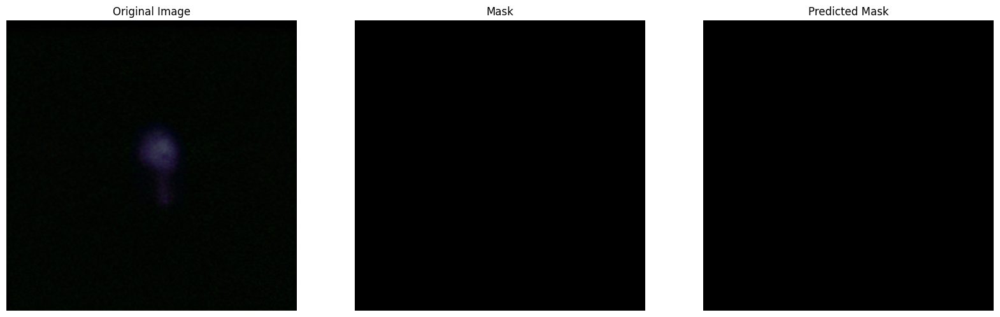

./lgg-mri-segmentation/kaggle_3m/TCGA_DU_7010_19860307/TCGA_DU_7010_19860307_51.tif


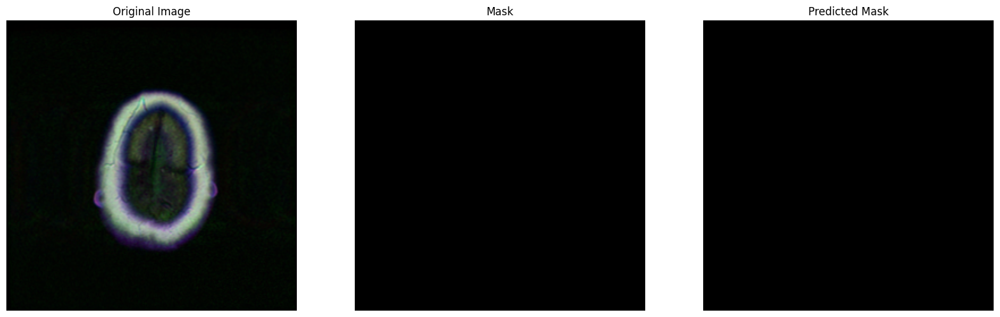

./lgg-mri-segmentation/kaggle_3m/TCGA_DU_7010_19860307/TCGA_DU_7010_19860307_23.tif


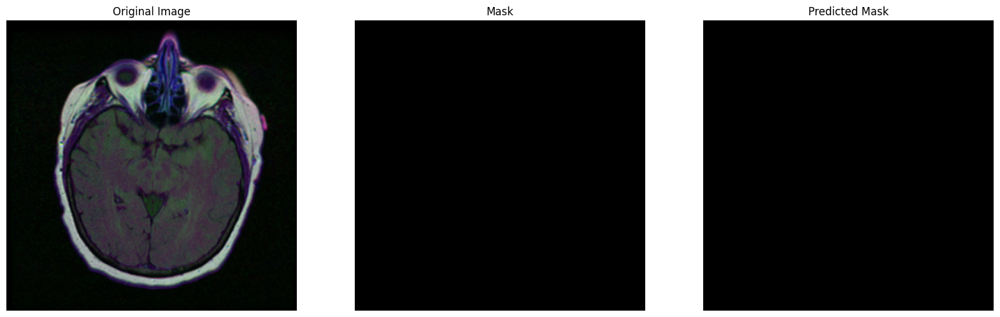

./lgg-mri-segmentation/kaggle_3m/TCGA_DU_7010_19860307/TCGA_DU_7010_19860307_58.tif


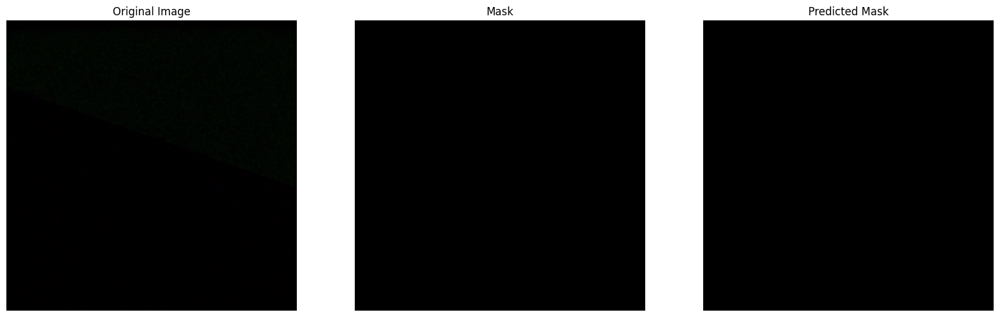

./lgg-mri-segmentation/kaggle_3m/TCGA_DU_7010_19860307/TCGA_DU_7010_19860307_20.tif


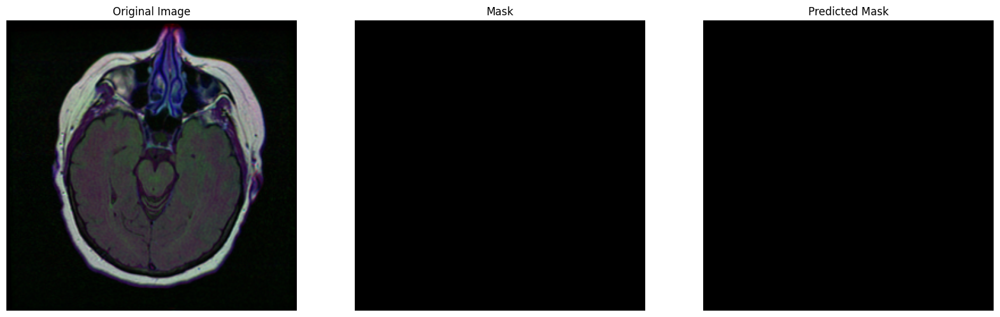

./lgg-mri-segmentation/kaggle_3m/TCGA_DU_7010_19860307/TCGA_DU_7010_19860307_3.tif


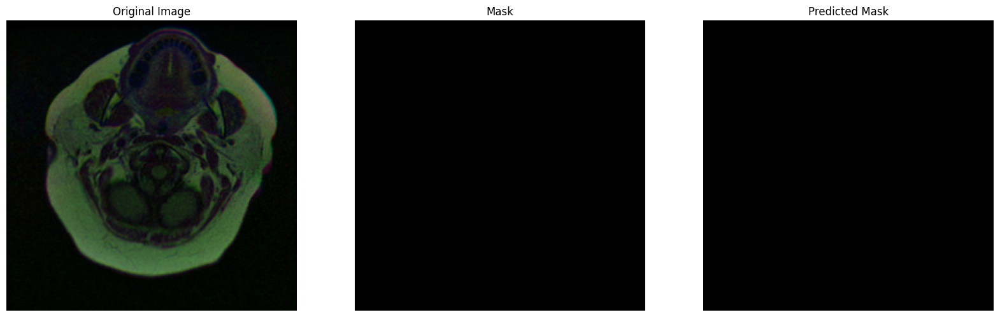

./lgg-mri-segmentation/kaggle_3m/TCGA_DU_7010_19860307/TCGA_DU_7010_19860307_12.tif


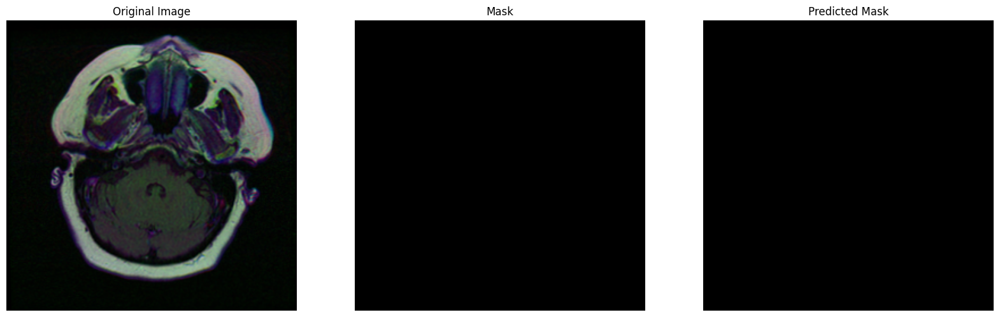

./lgg-mri-segmentation/kaggle_3m/TCGA_DU_7010_19860307/TCGA_DU_7010_19860307_13.tif


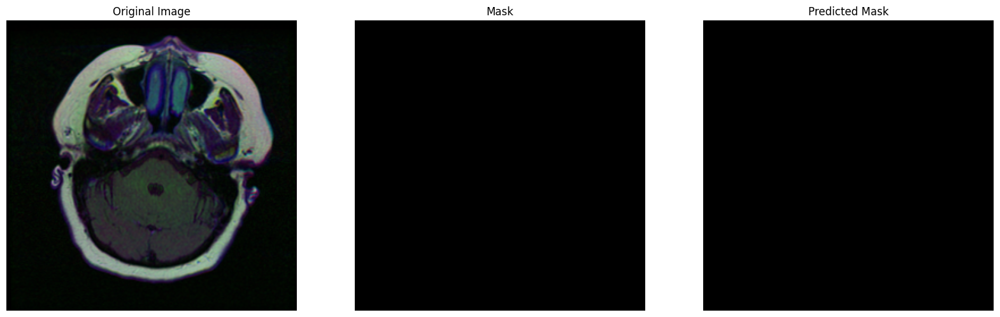

./lgg-mri-segmentation/kaggle_3m/TCGA_DU_7010_19860307/TCGA_DU_7010_19860307_8.tif


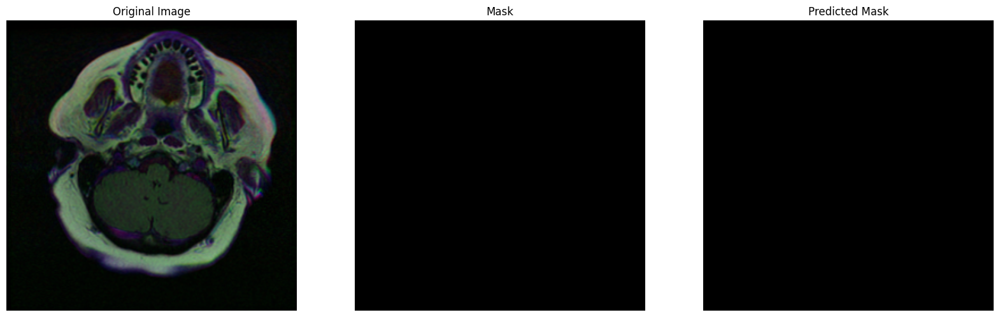

./lgg-mri-segmentation/kaggle_3m/TCGA_DU_7010_19860307/TCGA_DU_7010_19860307_14.tif


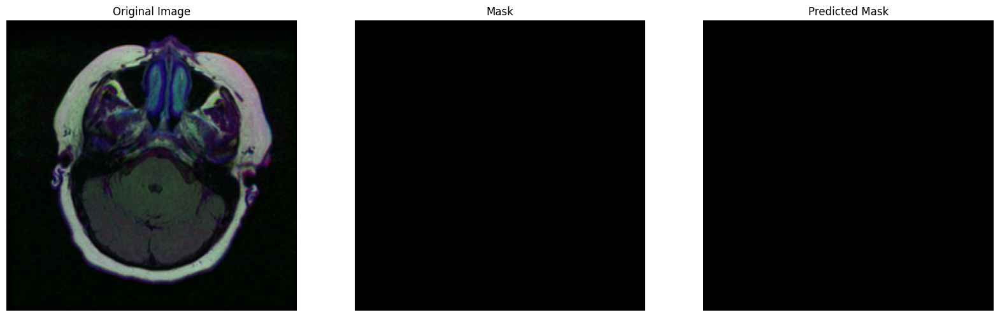

./lgg-mri-segmentation/kaggle_3m/TCGA_DU_7010_19860307/TCGA_DU_7010_19860307_7.tif


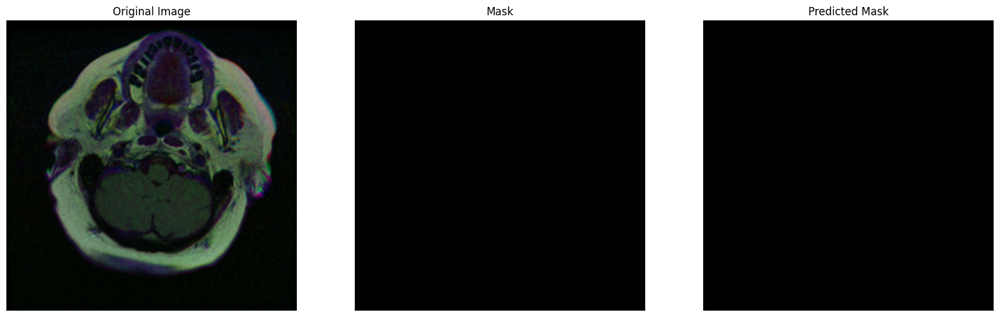

./lgg-mri-segmentation/kaggle_3m/TCGA_DU_7010_19860307/TCGA_DU_7010_19860307_17.tif


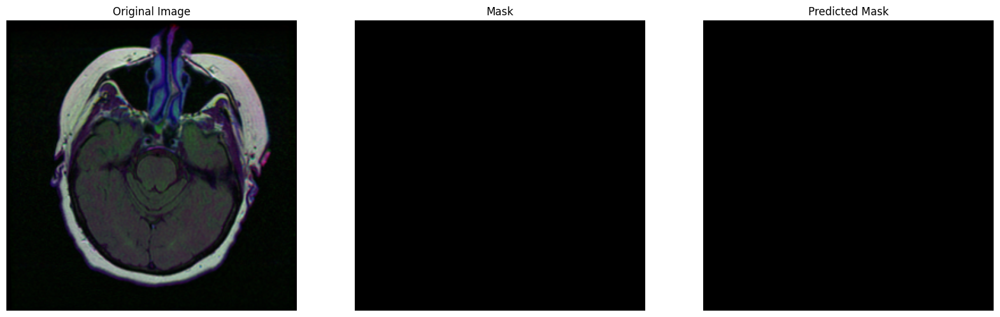

./lgg-mri-segmentation/kaggle_3m/TCGA_DU_7010_19860307/TCGA_DU_7010_19860307_10.tif


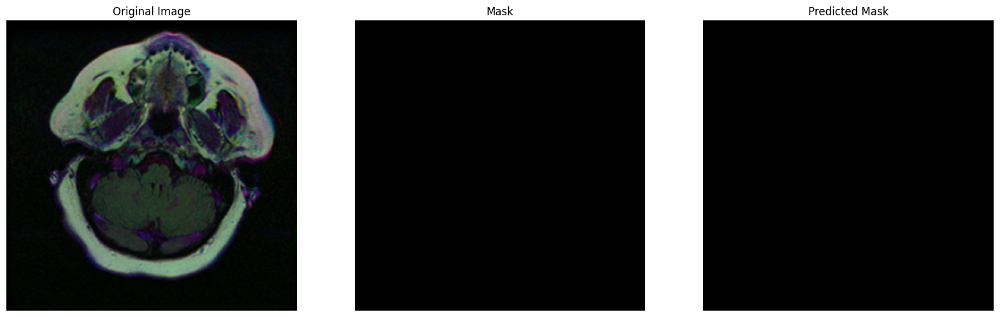

./lgg-mri-segmentation/kaggle_3m/TCGA_DU_7010_19860307/TCGA_DU_7010_19860307_18.tif


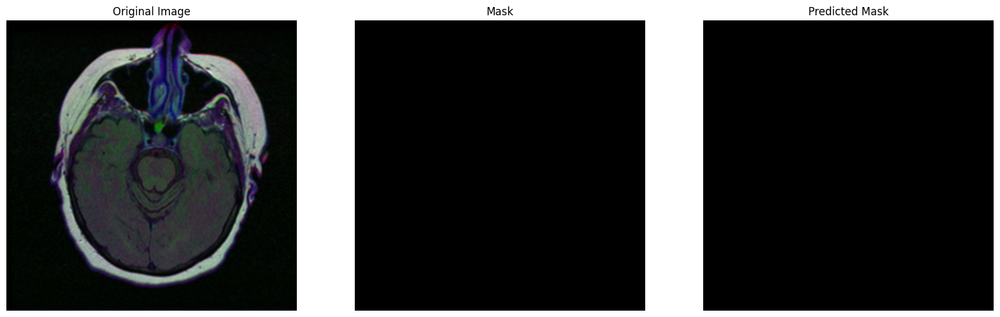

./lgg-mri-segmentation/kaggle_3m/TCGA_DU_7010_19860307/TCGA_DU_7010_19860307_9.tif


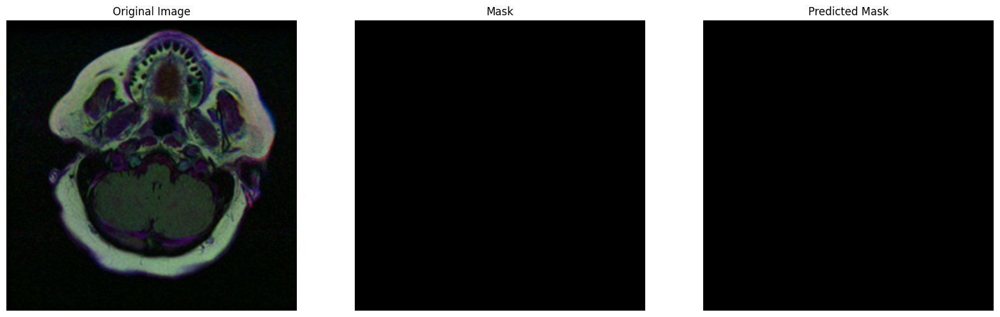

./lgg-mri-segmentation/kaggle_3m/TCGA_DU_7010_19860307/TCGA_DU_7010_19860307_19.tif


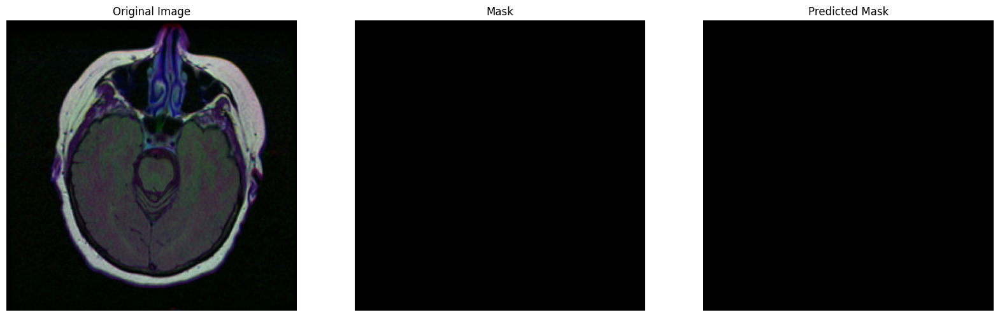

In [10]:
for image_path, mask_path in zip(no_tumors["image_path"][:20], no_tumors["mask_path"][:20]):
    print(image_path)
    predicted_mask = predict_mask(model, image_path, device)
    image = Image.open(image_path)
    mask = Image.open(mask_path)
    print_res(image, mask, predicted_mask)